# Global Wheat Detection 

The Global Wheat Head Dataset is led by nine research institutes from seven countries: the University of Tokyo, Institut national de recherche pour l’agriculture, l’alimentation et l’environnement, Arvalis, ETHZ, University of Saskatchewan, University of Queensland, Nanjing Agricultural University, and Rothamsted Research. These institutions are joined by many in their pursuit of accurate wheat head detection, including the Global Institute for Food Security, DigitAg, Kubota, and Hiphen.

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# import useful tools
from glob import glob
from PIL import Image
import cv2

# import data visualization
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns

from bokeh.plotting import figure
from bokeh.io import output_notebook, show, output_file
from bokeh.models import ColumnDataSource, HoverTool, Panel
from bokeh.models.widgets import Tabs

# import data augmentation
import albumentations as albu

## General Dataset Information

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


`1` The number of train and test images:

In [ ]:
# Setup the paths to train and test images
TRAIN_DIR = '/content/drive/MyDrive/Datasets/global_wheat_detection/train/'
TEST_DIR = '/content/drive/MyDrive/Datasets/global_wheat_detection/test/'
TRAIN_CSV_PATH = '/content/drive/MyDrive/Datasets/global_wheat_detection/train.csv'

# Glob the directories and get the lists of train and test images
train_fns = glob(TRAIN_DIR + '*')
test_fns = glob(TEST_DIR + '*')

Compute at the number of train and test images:

In [ ]:
print('Number of train images is {}'.format(len(train_fns)))
print('Number of test images is {}'.format(len(test_fns)))

Number of train images is 3422
Number of test images is 10



Just `3422` images for the training.

`2` The number of bounding boxes (wheat spikes) per image:

Construct dataframe with all images (images with no bboxes will have nan values in all columns except `image_id`):

In [ ]:
# Load the dataframe with the bounding boxes
train = pd.read_csv(TRAIN_CSV_PATH)

# Create a dataframe with all train images
all_train_images = pd.DataFrame([fns.split('/')[-1][:-4] for fns in train_fns])
all_train_images.columns=['image_id']

# Merge all train images with the bounding boxes dataframe
all_train_images = all_train_images.merge(train, on='image_id', how='left')

# replace nan values with zeros
all_train_images['bbox'] = all_train_images.bbox.fillna('[0,0,0,0]')

# split bbox column
bbox_items = all_train_images.bbox.str.split(',', expand=True)
all_train_images['bbox_xmin'] = bbox_items[0].str.strip('[ ').astype(float)
all_train_images['bbox_ymin'] = bbox_items[1].str.strip(' ').astype(float)
all_train_images['bbox_width'] = bbox_items[2].str.strip(' ').astype(float)
all_train_images['bbox_height'] = bbox_items[3].str.strip(' ]').astype(float)

In [ ]:
print('{} images without wheat heads.'.format(len(all_train_images) - len(train)))

49 images without wheat heads.


Plot some image examples:

In [ ]:
def get_all_bboxes(df, image_id):
    image_bboxes = df[df.image_id == image_id]
    
    bboxes = []
    for _,row in image_bboxes.iterrows():
        bboxes.append((row.bbox_xmin, row.bbox_ymin, row.bbox_width, row.bbox_height))
        
    return bboxes

def plot_image_examples(df, rows=3, cols=3, title='Image examples'):
    fig, axs = plt.subplots(rows, cols, figsize=(20,16))
    for row in range(rows):
        for col in range(cols):
            idx = np.random.randint(len(df), size=1)[0]
            img_id = df.iloc[idx].image_id
            
            img = Image.open(TRAIN_DIR + img_id + '.jpg')
            axs[row, col].imshow(img)
            
            bboxes = get_all_bboxes(df, img_id)
            
            for bbox in bboxes:
                rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=1,edgecolor='r',facecolor='none')
                axs[row, col].add_patch(rect)
            
            axs[row, col].axis('off')
            
    plt.suptitle(title)

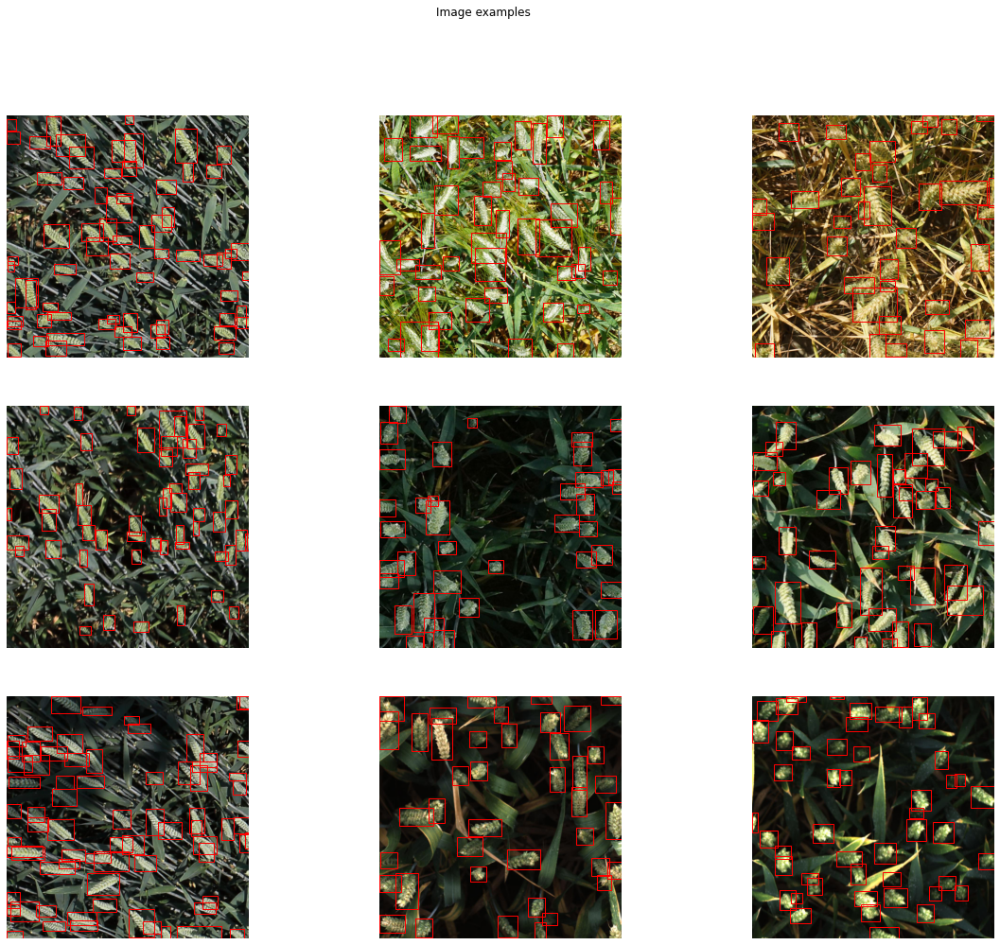

In [ ]:
plot_image_examples(all_train_images)

Count number of bounding boxes per image:

In [ ]:
# compute the number of bounding boxes per train image
all_train_images['count'] = all_train_images.apply(lambda row: 1 if np.isfinite(row.width) else 0, axis=1)
train_images_count = all_train_images.groupby('image_id').sum().reset_index()

In [ ]:
def hist_hover(dataframe, column, colors=["#94c8d8", "#ea5e51"], bins=30, title=''):
    hist, edges = np.histogram(dataframe[column], bins = bins)
    
    hist_df = pd.DataFrame({column: hist,
                             "left": edges[:-1],
                             "right": edges[1:]})
    hist_df["interval"] = ["%d to %d" % (left, right) for left, 
                           right in zip(hist_df["left"], hist_df["right"])]

    src = ColumnDataSource(hist_df)
    plot = figure(plot_height = 400, plot_width = 600,
          title = title,
          x_axis_label = column,
          y_axis_label = "Count")    
    plot.quad(bottom = 0, top = column,left = "left", 
        right = "right", source = src, fill_color = colors[0], 
        line_color = "#35838d", fill_alpha = 0.7,
        hover_fill_alpha = 0.7, hover_fill_color = colors[1])
        
    hover = HoverTool(tooltips = [('Interval', '@interval'),
                              ('Count', str("@" + column))])
    plot.add_tools(hover)
    
    output_notebook()
    show(plot)

In [ ]:
hist_hover(train_images_count, 'count', title='Number of wheat spikes per image')

Most of the images have 20-50 wheat spikes on them.

Plot some examples with small number of spikes per image:

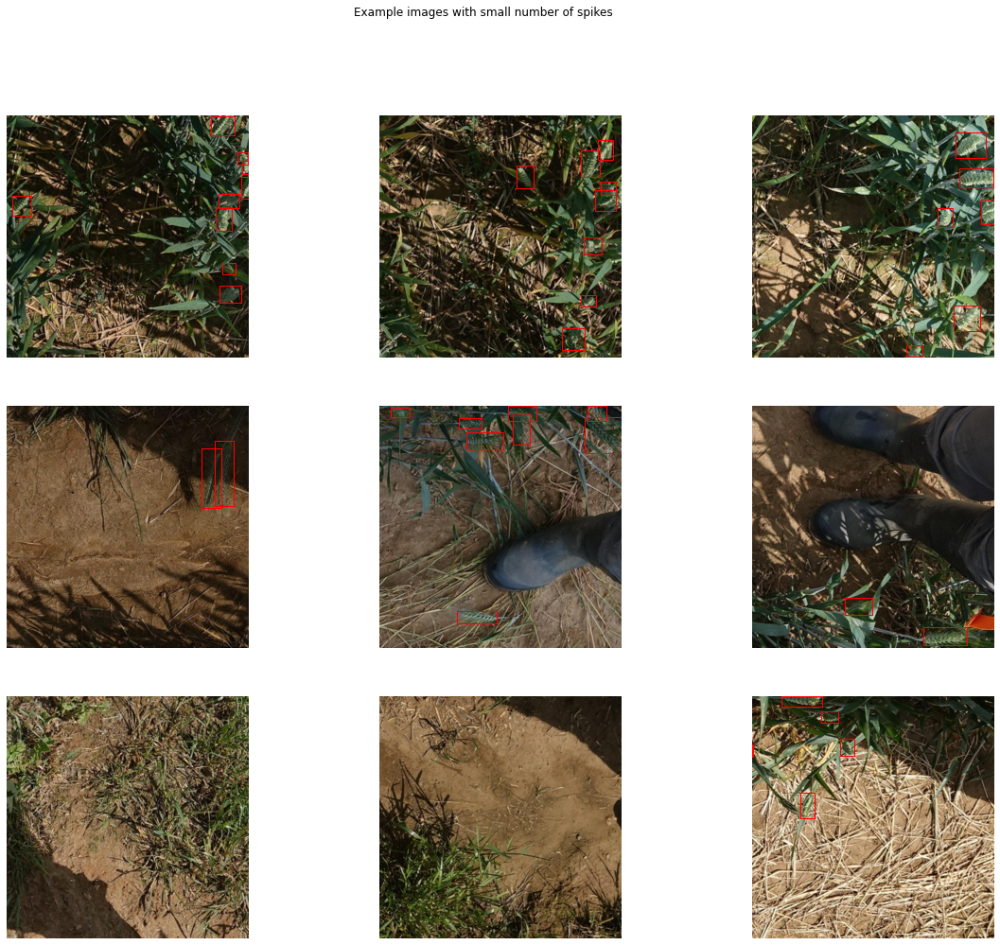

In [ ]:
less_spikes_ids = train_images_count[train_images_count['count'] < 10].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(less_spikes_ids)], title='Example images with small number of spikes')

* on some of the images all we see is the ground;
* some of the images are just zoomed in a lot.

Plot the images with many spikes:

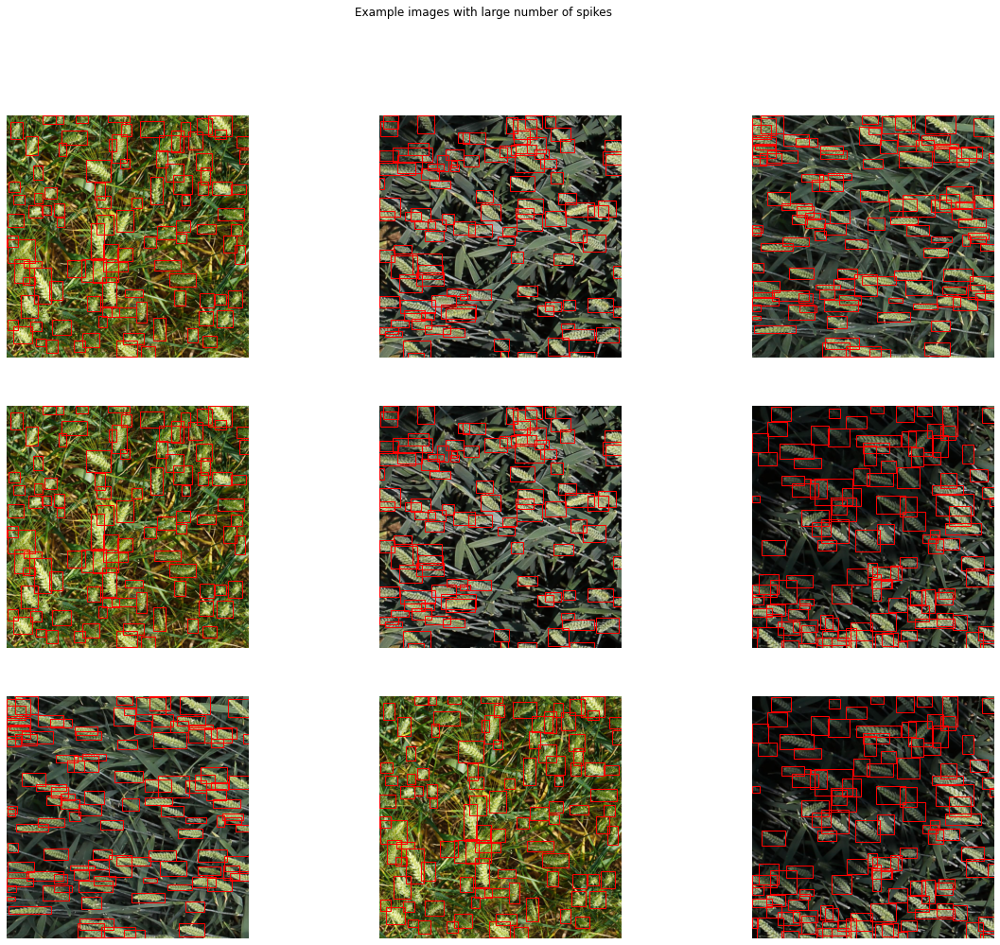

In [ ]:
many_spikes_ids = train_images_count[train_images_count['count'] > 100].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(many_spikes_ids)], title='Example images with large number of spikes')

`3` Area of bounding boxes:

In [ ]:
# compute bounding box areas
all_train_images['bbox_area'] = all_train_images['bbox_width'] * all_train_images['bbox_height']

In [ ]:
# plot a histogram of bounding box areas
hist_hover(all_train_images, 'bbox_area', title='Area of a single bounding box')

The maximum area of bounding box:

In [ ]:
all_train_images.bbox_area.max()

529788.0

Let's plot some examples of large bounding boxes:

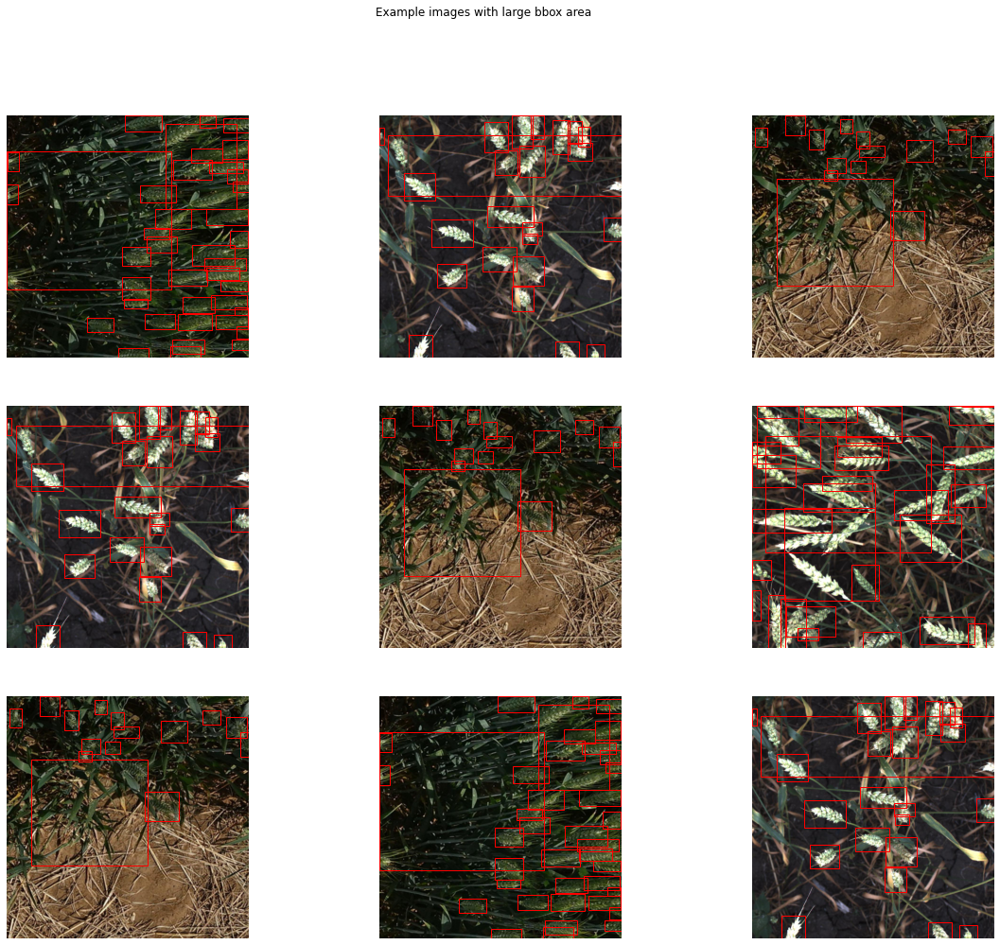

In [ ]:
large_boxes_ids = all_train_images[all_train_images['bbox_area'] > 200000].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(large_boxes_ids)], title='Example images with large bbox area')

Here we could see them some images have anomaly huge boxes. Possibly it's error which occured while during image labeling

Similarly, let's look at very small bounding boxes:

In [ ]:
min_area = all_train_images[all_train_images['bbox_area'] > 0].bbox_area.min()
print('The smallest bounding box area is {}'.format(min_area))

The smallest bounding box area is 2.0


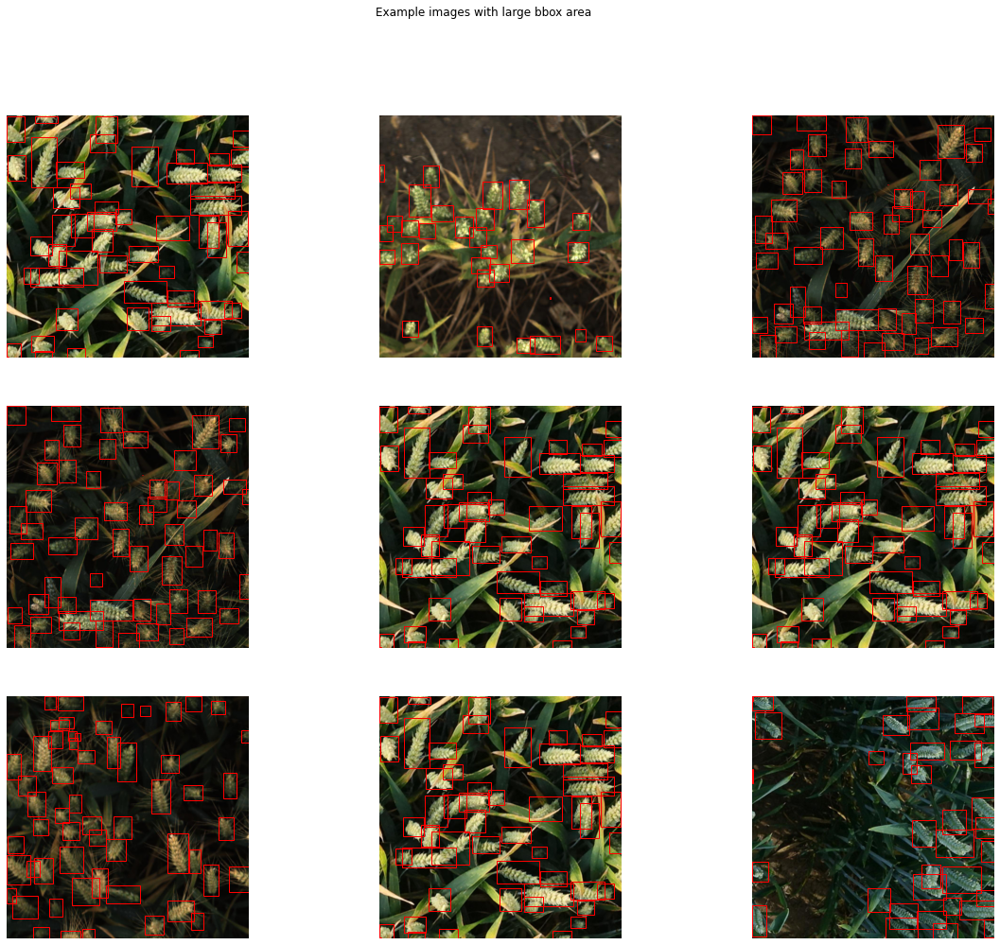

In [ ]:
small_boxes_ids = all_train_images[(all_train_images['bbox_area'] < 50) & (all_train_images['bbox_area'] > 0)].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(small_boxes_ids)], title='Example images with large bbox area')

`4` Area of bounding boxes per image:

In [ ]:
# compute the total bounding boxes area per image
area_per_image = all_train_images.groupby(by='image_id').sum().reset_index()

# compute the percentage of the image area covered by bounding boxes
area_per_image_percentage = area_per_image.copy()
area_per_image_percentage['bbox_area'] = area_per_image_percentage['bbox_area'] / (1024*1024) * 100

In [ ]:
hist_hover(area_per_image_percentage, 'bbox_area', title='Percentage of image area covered by bounding boxes')

This looks like a nice normal distribution! 20-40% of the image area is covered by the bounding boxes.

We can also see that the maximum is actually greater than 100%. This means that the bounding boxes are overlapping.

Let's look at some examples of images with small areas covered by bounding boxes:

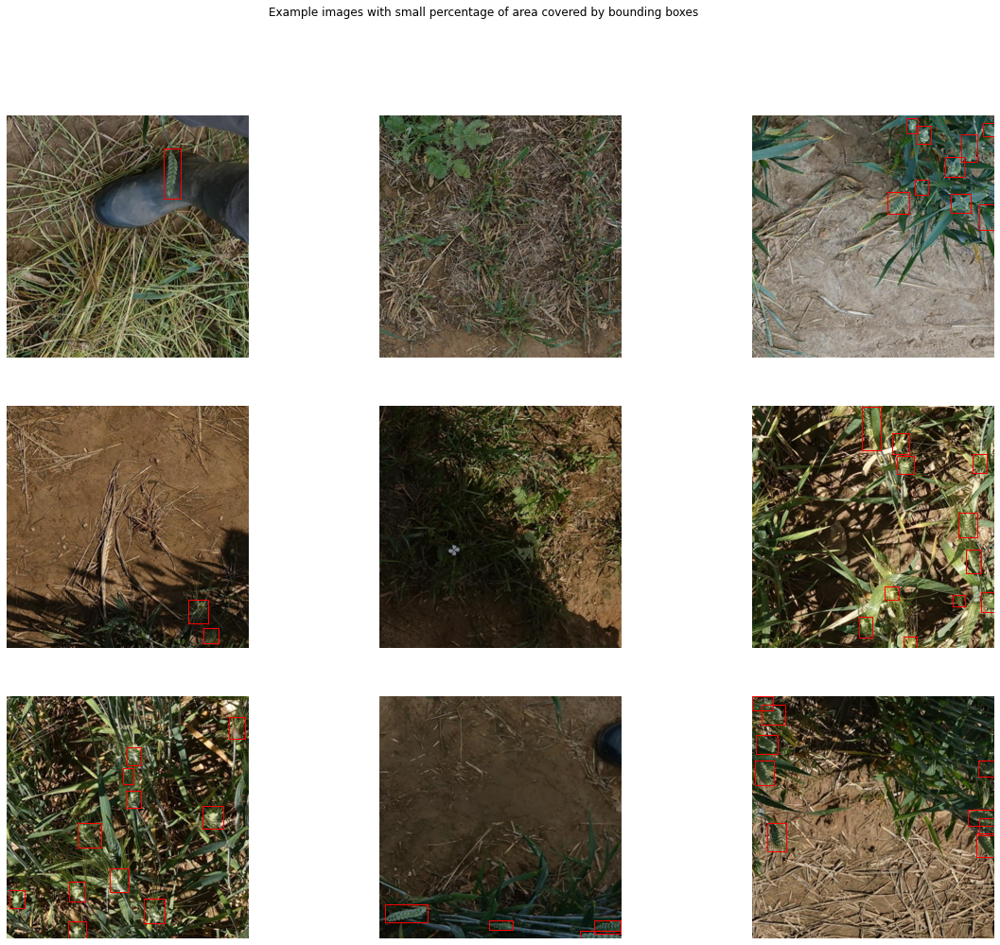

In [ ]:
small_area_perc_ids = area_per_image_percentage[area_per_image_percentage['bbox_area'] < 7].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(small_area_perc_ids)], title='Example images with small percentage of area covered by bounding boxes')

Now let's plot the images with large areas covered by bounding boxes:

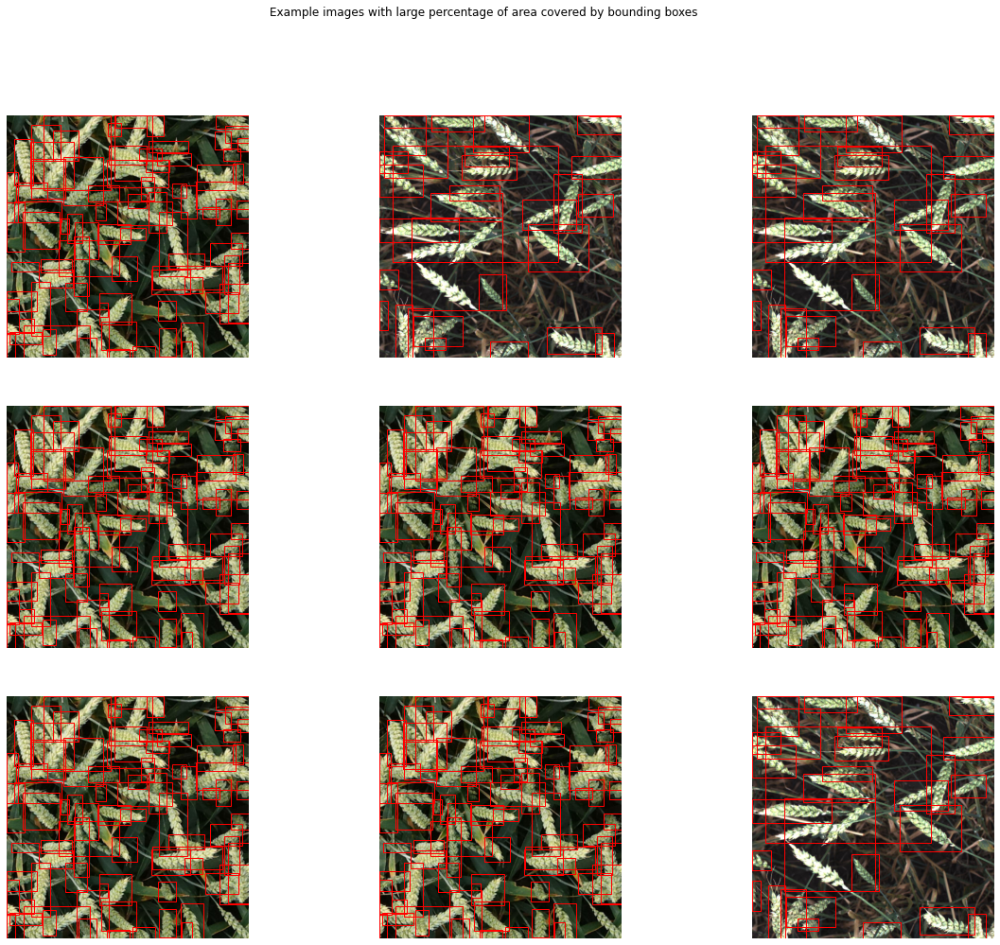

In [ ]:
large_area_perc_ids = area_per_image_percentage[area_per_image_percentage['bbox_area'] > 95].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(large_area_perc_ids)], title='Example images with large percentage of area covered by bounding boxes')

## Modeling

We will use YOLO algorithm for object detection. Details https://arxiv.org/pdf/1506.02640v5.pdf

In [ ]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 4, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 4319 (delta 0), reused 1 (delta 0), pack-reused 4315
Receiving objects: 100% (4319/4319), 7.34 MiB | 36.29 MiB/s, done.
Resolving deltas: 100% (2925/2925), done.


In [ ]:
!mv yolov5/* ./

In [ ]:
!pip install -r requirements.txt

     |████████████████████████████████| 645kB 8.6MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
import pandas as pd
import numpy as np
import os
from tqdm.auto import tqdm
import shutil as sh
from sklearn.model_selection import train_test_split

In [ ]:
data_path = '/content/drive/MyDrive/Datasets/global_wheat_detection'
df = pd.read_csv(os.path.join(data_path, 'train.csv'))
bboxs = np.stack(df['bbox'].apply(lambda x: np.fromstring(x[1:-1], sep=',')))
for i, column in enumerate(['x', 'y', 'w', 'h']):
    df[column] = bboxs[:,i]
df.drop(columns=['bbox'], inplace=True)
df['x_center'] = df['x'] + df['w']/2
df['y_center'] = df['y'] + df['h']/2
df['classes'] = 0
df = df[['image_id','x', 'y', 'w', 'h','x_center','y_center','classes']]
index = list(set(df.image_id))

For training we will split out train dataset into validation dataset and training datasets and create separate folders for them.

In [ ]:
train_idx, val_idx = train_test_split(df['image_id'].unique(), test_size = 0.1, random_state = 42)

In [ ]:
source = 'train'
for name,mini in tqdm(df.groupby('image_id')):
    if name in val_idx:
        path2save = 'val'
    else:
        path2save = 'train'
    if not os.path.exists('convertor/labels/{}'.format(path2save)):
        os.makedirs('convertor/labels/{}'.format(path2save))
    with open('convertor/labels/' + path2save+ '/' + name+".txt", 'w+') as f:
      row = mini[['classes','x_center','y_center','w','h']].astype(float).values
      row = row/1024
      row = row.astype(str)
      for j in range(len(row)):
          text = ' '.join(row[j])
          f.write(text)
          f.write("\n")
      if not os.path.exists('convertor/images/{}'.format(path2save)):
        os.makedirs('convertor/images/{}'.format(path2save))
      sh.copy("/content/drive/MyDrive/Datasets/global_wheat_detection/{}/{}.jpg".format(source,name),
                    'convertor/images/{}/{}.jpg'.format(path2save,name))

Download weights for YOLOv5

In [ ]:
! sh weights/download_weights.sh

100% 14.1M/14.1M [00:00<00:00, 21.8MB/s]

100% 41.1M/41.1M [00:01<00:00, 32.2MB/s]

100% 90.2M/90.2M [00:02<00:00, 39.7MB/s]

100% 168M/168M [00:04<00:00, 43.7MB/s]



Next step we will create wheat0.yaml file where we define path to our train and valid datasets and put it into data directory. Below how the file should look like

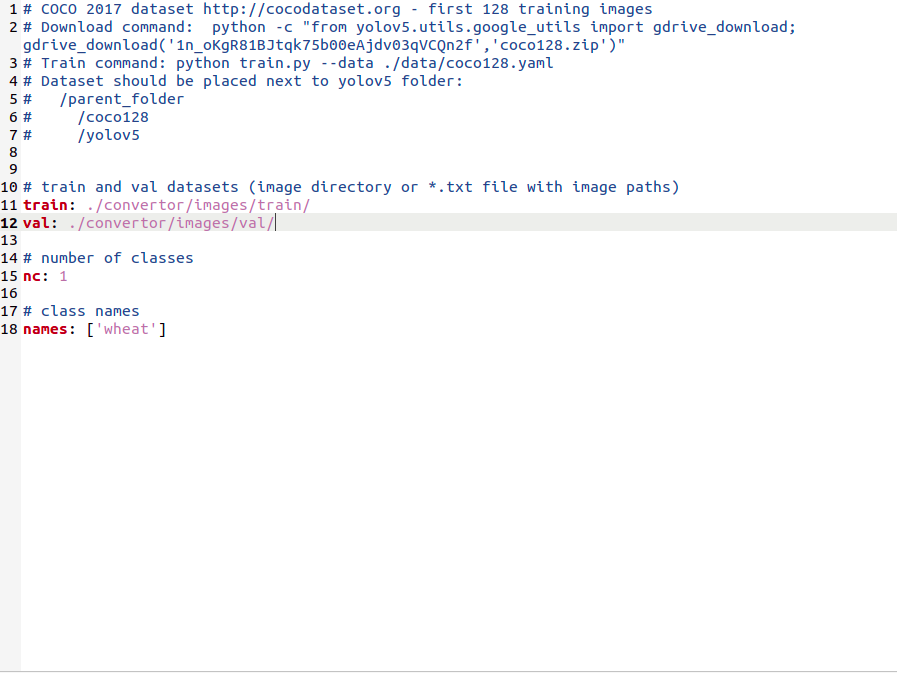

Now we can start training process

In [ ]:
!python train.py --img 1024 --batch 4 --epochs 10 --data wheat0.yaml --weights yolov5x.pt --cfg yolov5x.yaml --name yolov5x_wheat

github: skipping check (not a git repository)
YOLOv5  torch 1.7.0+cu101 CUDA:0 (Tesla T4, 15079.75MB)

Namespace(adam=False, batch_size=4, bucket='', cache_images=False, cfg='./models/yolov5x.yaml', data='./data/wheat0.yaml', device='', epochs=10, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[1024, 1024], local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='yolov5x_wheat', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5x_wheat', single_cls=False, sync_bn=False, total_batch_size=4, weights='yolov5x.pt', workers=8, world_size=1)
wandb: Install Weights & Biases for YOLOv5 logging with 'pip install wandb' (recommended)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2021-01-21 09:51:50.815780: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic

Validation mAP looks pretty good. Let's see how our prediction looks on new images.

In [ ]:
!python detect.py --weights ./runs/train/yolov5x_wheat/weights/best.pt --img 1024 --conf 0.25 --source '/content/drive/MyDrive/Datasets/global_wheat_detection/test'

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.25, device='', exist_ok=False, img_size=1024, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/drive/MyDrive/Datasets/global_wheat_detection/test', update=False, view_img=False, weights=['./runs/train/yolov5x_wheat/weights/best.pt'])
YOLOv5  torch 1.7.0+cu101 CUDA:0 (Tesla T4, 15079.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients, 217.1 GFLOPS
image 1/10 /content/drive/MyDrive/Datasets/global_wheat_detection/test/2fd875eaa.jpg: 1024x1024 30 wheats, Done. (0.077s)
image 2/10 /content/drive/MyDrive/Datasets/global_wheat_detection/test/348a992bb.jpg: 1024x1024 38 wheats, Done. (0.077s)
image 3/10 /content/drive/MyDrive/Datasets/global_wheat_detection/test/51b3e36ab.jpg: 1024x1024 27 wheats, Done. (0.077s)
image 4/10 /content/drive/MyDrive/Datasets/global_wheat_detection/test/51f1be19e.jpg: 1024x1024 19 wheats, Done. (0.100s)
image

In [ ]:
img_list = os.listdir('./runs/detect/exp2/')
detect_path = './runs/detect/exp2'

In [ ]:
import matplotlib.pyplot as plt
import cv2

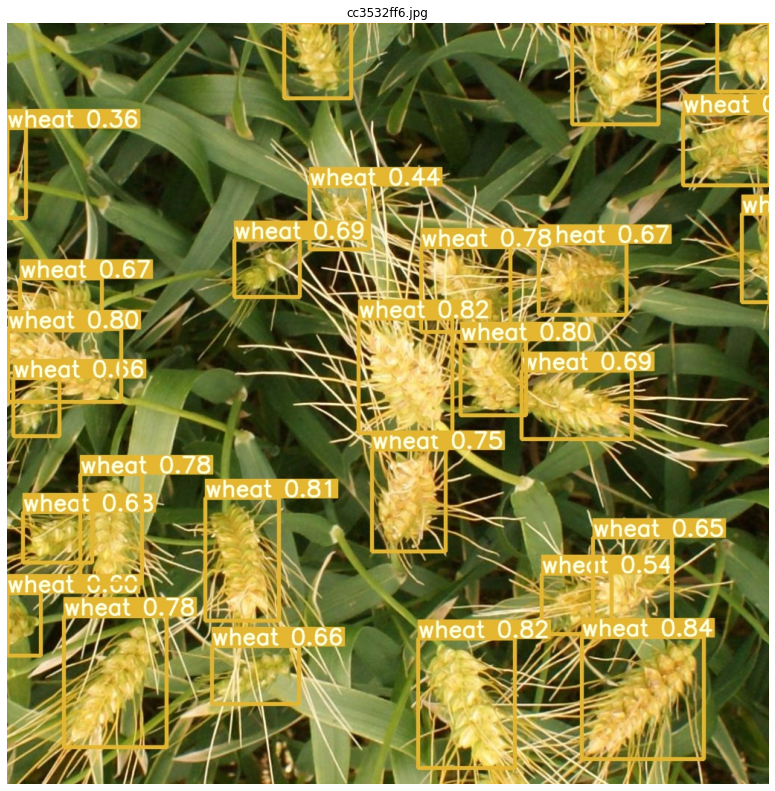

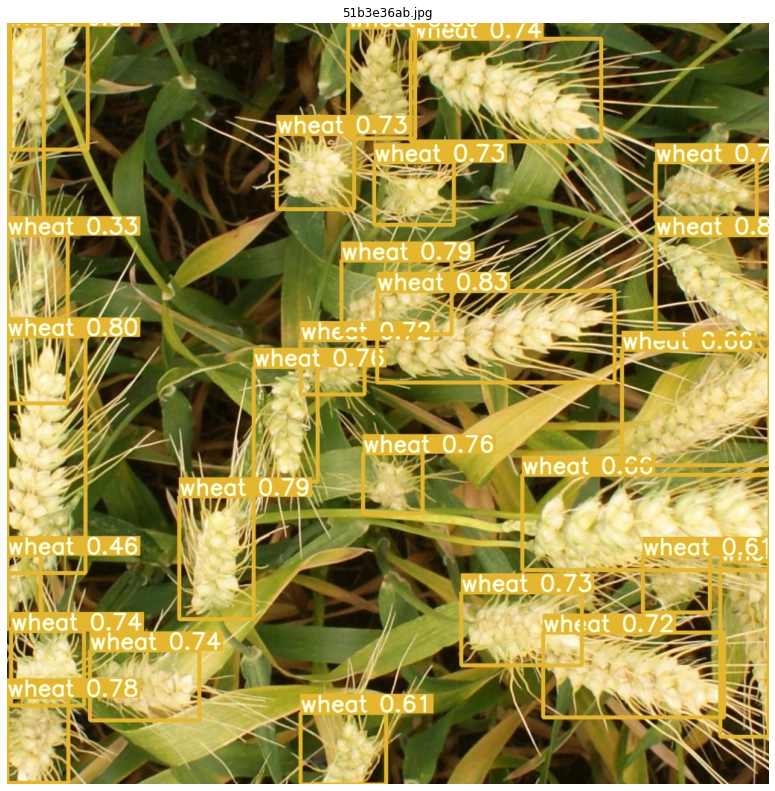

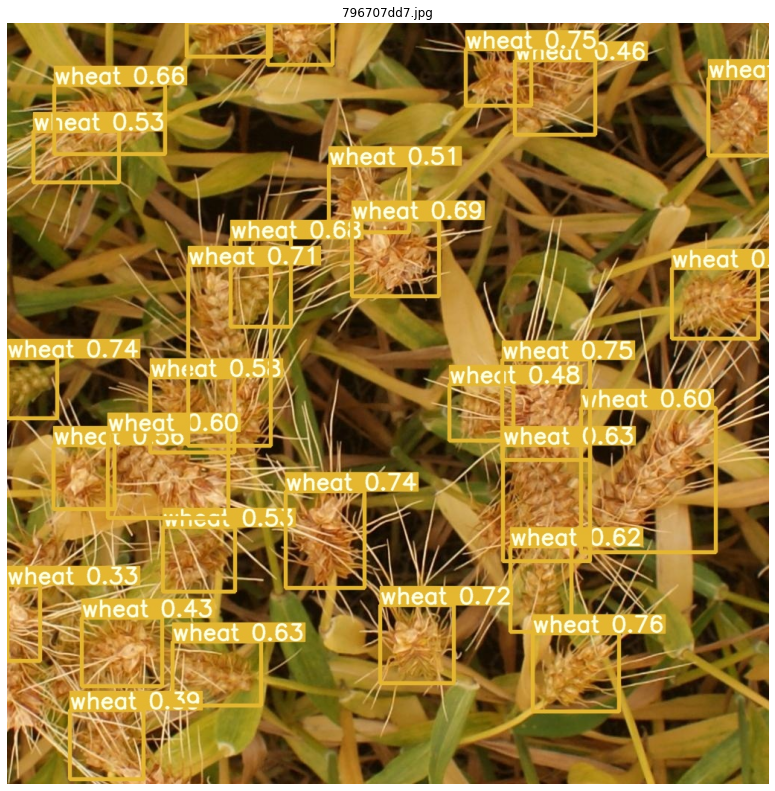

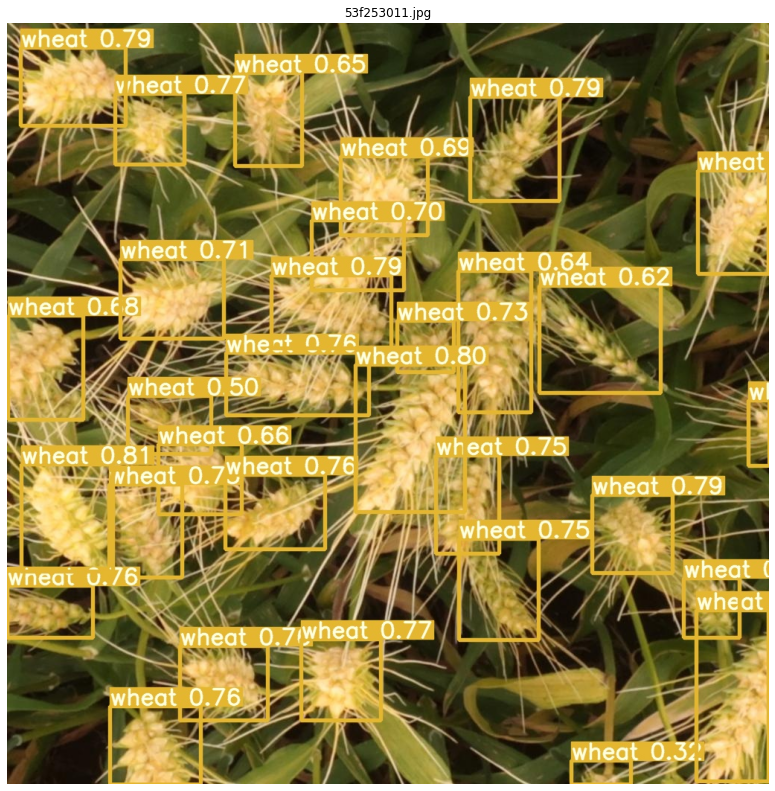

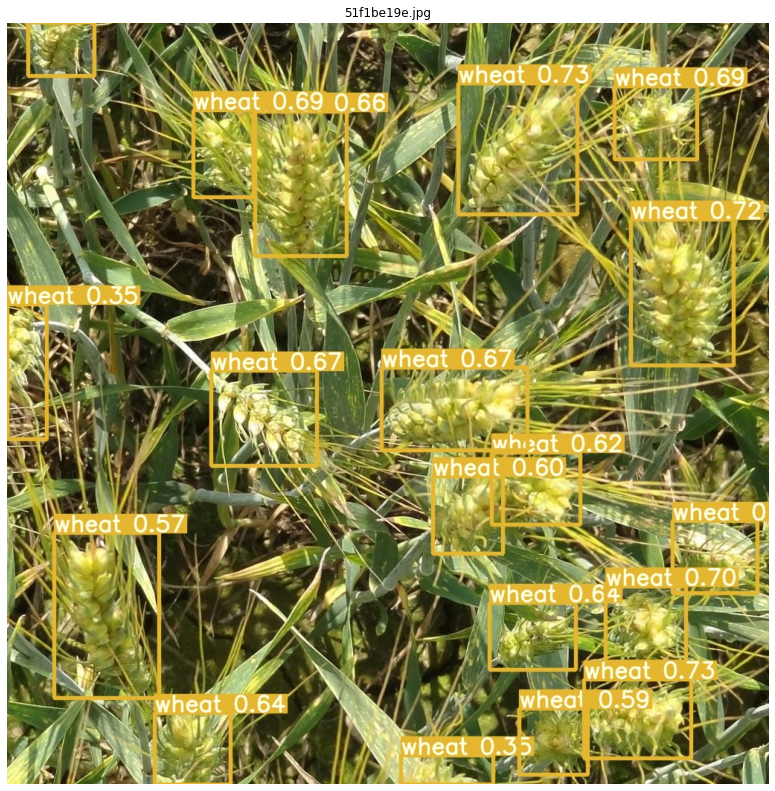

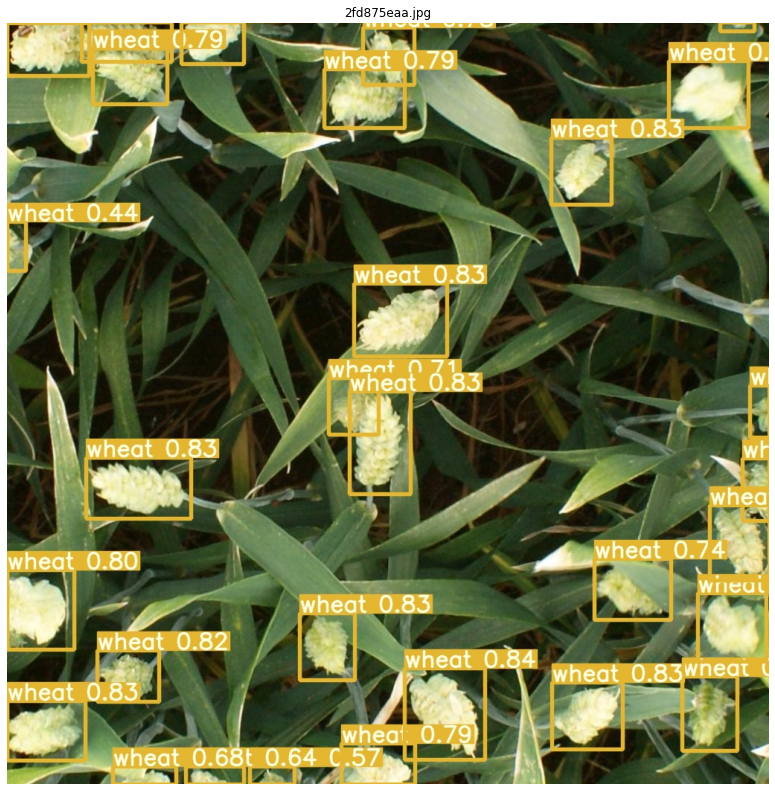

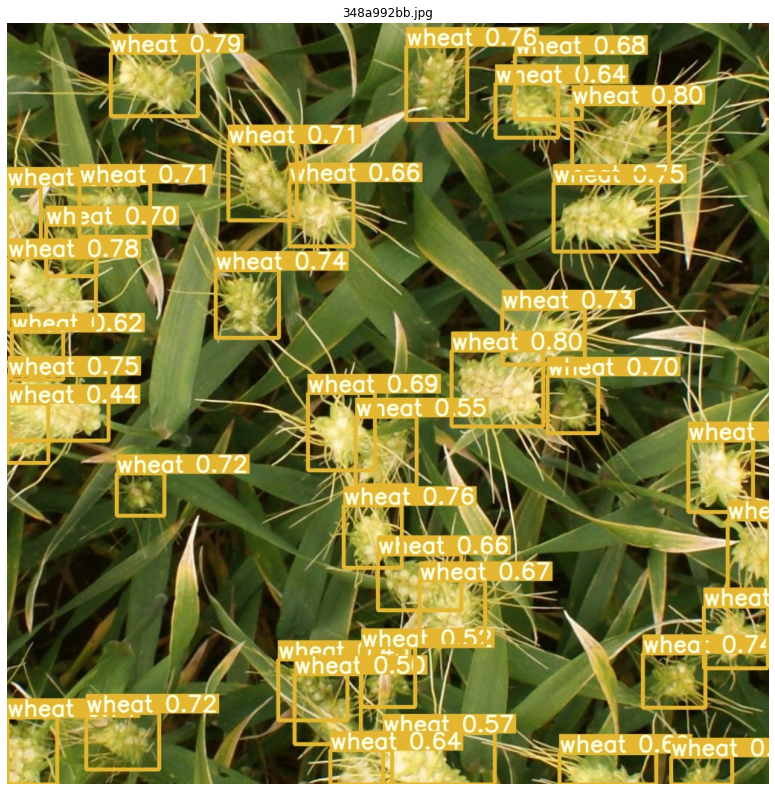

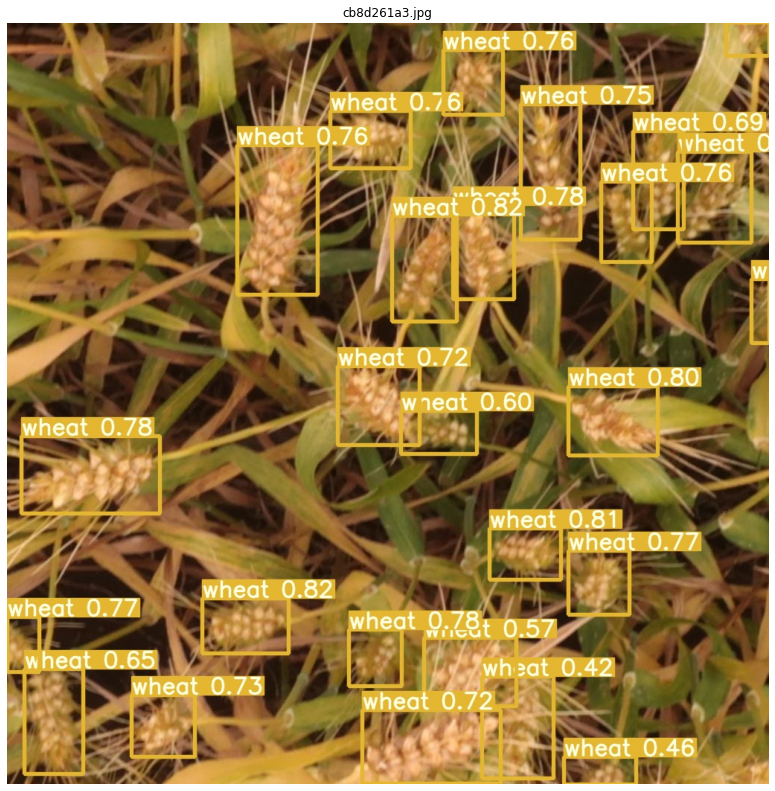

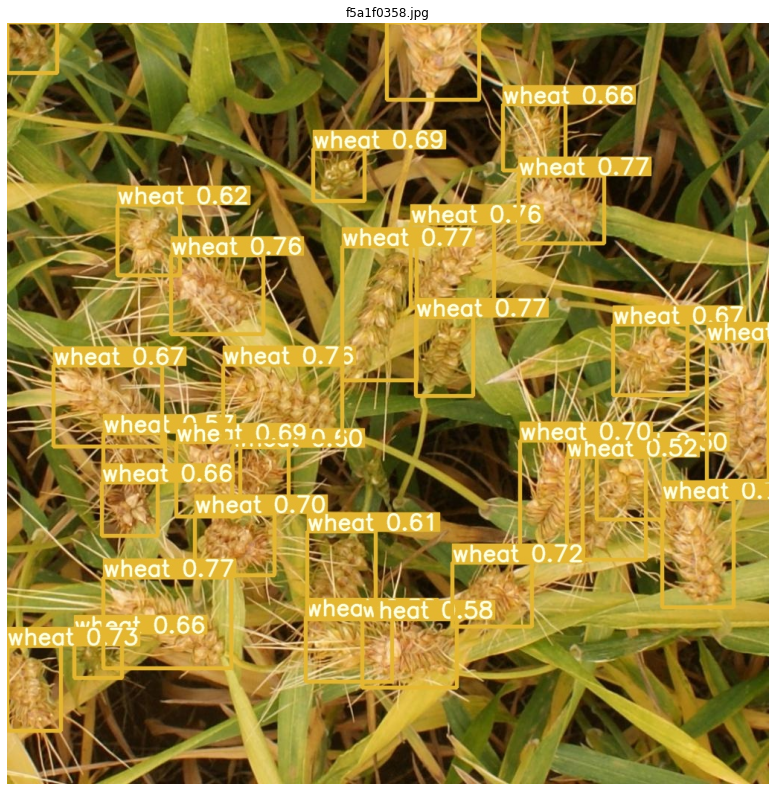

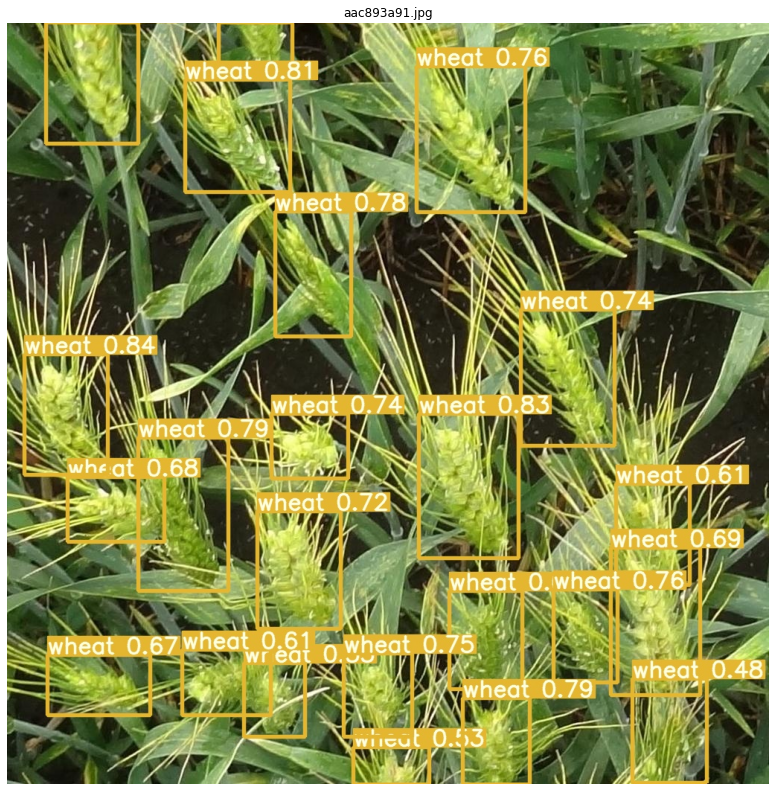

In [ ]:
for img_str in img_list:
  im = cv2.imread(os.path.join(detect_path, img_str))
  im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  plt.figure(figsize = (16, 14))
  plt.imshow(im)
  plt.title(img_str)
  plt.axis('off')